# Library

In [1]:
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt

#Plotly
import plotly.graph_objects as go
import plotly

# Seaborn
import plotly.express as px
import seaborn as sb
sb.set(color_codes=True)

In [2]:
import os
os.getcwd()

'C:\\Users\\maxdo\\OneDrive\\Documents\\INSA\\5A\\DefiIA\\notebook'

# Data

In [3]:
DATA_PATH = "C:/Users/maxdo/OneDrive/Documents/INSA/5A/TestIA"

train_df = pd.read_json(DATA_PATH+"/train.json")
#train_df.set_index('Id', inplace=True) 

test_df = pd.read_json(DATA_PATH+"/test.json")
#test_df.set_index('Id', inplace=True) 


train_label = pd.read_csv(DATA_PATH+"/train_label.csv")
#train_label.set_index('Id', inplace=True)

categ = pd.read_csv(DATA_PATH+'/categories_string.csv')

template_submissions = pd.read_csv(DATA_PATH + "/template_submissions.csv")

In [4]:
pd.options.display.max_colwidth = 1000

In [5]:
display(train_df.head(5))

,Id,description,gender
0,0,"She is also a Ronald D. Asmus Policy Entrepreneur Fellow with the German Marshall Fund and is a Visiting Fellow at the Centre for International Studies (CIS) at the University of Oxford. This commentary first appeared at Sada, an online journal published by the Carnegie Endowment for International Peace.",F
1,1,"He is a member of the AICPA and WICPA. Brent graduated from the University of Wisconsin, La Crosse, with a degree in accountancy. He has lived in southern Wisconsin his entire life, and currently resides in Pardeeville with his wife Sara and their three children. Brent and Sara have a great appreciation of music, art, and theater.",M
2,2,"Dr. Aster has held teaching and research positions at Ben Gurion University, Haifa University, Hebrew University, Bar Ilan University and the University of Pennsylvania. He has also taught Jewish studies at high schools in the United Stated and Israel.",M
4,3,"He runs a boutique design studio attending clients in the United States, Europe and Asia. His work explores the convergence of human arts and science to give shape to an ever evolving design practice. With a particular commitment towards design education, Arturo is permanently engaged with the international design and development communities and often travels the world to exchange ideas about design with other designers and developers. Prior to his current venture, Arturo worked for Microsoft in Redmond for 7 years driving design evangelism.",M
5,4,"He focuses on cloud security, identity and access management, mobility security, and security for Microsoft platforms and solutions. Jan is based in Belgium.",M


In [131]:
with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    print(train_df.head(5))

   Id                                        description gender
0   0   She is also a Ronald D. Asmus Policy Entrepre...      F
1   1   He is a member of the AICPA and WICPA. Brent ...      M
2   2   Dr. Aster has held teaching and research posi...      M
4   3   He runs a boutique design studio attending cl...      M
5   4   He focuses on cloud security, identity and ac...      M


In [6]:
test_df.head(3)

,Id,description,gender
3,0,"She currently works on CNN’s newest primetime show, Parker Spitzer, where she researches for co-host Eliot Spitzer and produces guest segments on politics, economics, culture and foreign affairs. She has previously produced for CNN’s Weekend Newsroom, American Morning and for Good Morning America at ABC News. She has also written for the Pittsburgh Post-Gazette and several online publications.",F
6,1,"Lavalette’s photographs have been shown widely and his editorial work has been published in various magazines, including The New York Times Magazine, The New Yorker, Vice Magazine, The Wire and Pig Magazine, amongst others. Lavalette is the founding Publisher and Editor of Lay Flat as well as the Director of Light Work.",M
11,2,"Along with his academic and professional development, Gabriel has lived, studied and worked in New Orleans, Firenze, Madrid, Rome and London. Expertise",M


In [7]:
train_label.head(3)

,Id,Category
0,0,19
1,1,9
2,2,19


In [8]:
categ.rename(columns={'0':'Category name','1':'Category'}, inplace=True)
categ.head(3)

,Category name,Category
0,pastor,0
1,model,1
2,yoga_teacher,2


In [9]:
template_submissions.head(3)

,Id,Category
0,0,0
1,1,0
2,2,0


In [10]:
train_tot=pd.merge(train_df, train_label)
train_tot=pd.merge(train_tot, categ)

In [11]:
train_tot.head(5)

,Id,description,gender,Category,Category name
0,0,"She is also a Ronald D. Asmus Policy Entrepreneur Fellow with the German Marshall Fund and is a Visiting Fellow at the Centre for International Studies (CIS) at the University of Oxford. This commentary first appeared at Sada, an online journal published by the Carnegie Endowment for International Peace.",F,19,professor
1,2,"Dr. Aster has held teaching and research positions at Ben Gurion University, Haifa University, Hebrew University, Bar Ilan University and the University of Pennsylvania. He has also taught Jewish studies at high schools in the United Stated and Israel.",M,19,professor
2,10,"An elder in the United Methodist Church, she writes and lectures widely about African-American religion and is treasurer of the Society for the Study of Black Religion. She is an expert on women in the civil rights movement, and she wrote Witnessing and Testifying: Black Women, Religion, and Civil Rights (Augsburg Fortress, 2003). Contact 404-270-5527, RRoss@spelman.edu.",F,19,professor
3,11,"She has written numerous scholarly articles on topics concerning African-Americans and Christianity, evangelicalism, churches and politics. Contact 404-651-4842 (office), 404-651-3152 (department), polacb@panther.gsu.edu.",F,19,professor
4,12,"He is an expert on black Pentecostalism, an ordained minister in the Church of God in Christ and a member of the World Council of Churches and Pentecostals Joint Consultative Group. Contact 202-806-0753, flware@howard.edu.",M,19,professor


# Analyse du jeu de données d'entrainement

In [12]:
print("Number of jobs in the dataset : %d" %(len(train_tot.Category.unique())))
print("Number of people in the dataset : %d" %(len(train_tot.Id.unique())))

Number of jobs in the dataset : 28
Number of people in the dataset : 217197


### Nombre de personnes par métier

In [13]:
fig = px.histogram(train_tot, x="Category name", color="gender")
fig.show()

### Nombre de personnes par métier sous représenté

In [23]:
train_gb_category=train_tot.groupby('Category')

In [24]:
categ_kept=categ[(train_gb_category.count()['Id']<10000).values]['Category']

In [25]:
fig = px.histogram(train_tot[train_tot['Category'].isin(categ_kept)], x="Category name", color="gender")
fig.show()

Les métiers sont représentés de façon inéquitable, il y a par exemple beaucoup de professeurs mais peu de rappeur. De plus, les sexes sont également très mal réparties entre les différents métiers.

## Etude des descriptions :

In [26]:
length_descriptions = (train_tot.description.map(lambda train_tot :len(train_tot)))
print("Plus longue description :", max(length_descriptions), "mots")

Plus longue description : 968 mots


In [27]:
train_tot.head(10)

,Id,description,gender,Category,Category name
0,0,"She is also a Ronald D. Asmus Policy Entrepreneur Fellow with the German Marshall Fund and is a Visiting Fellow at the Centre for International Studies (CIS) at the University of Oxford. This commentary first appeared at Sada, an online journal published by the Carnegie Endowment for International Peace.",F,19,professor
1,2,"Dr. Aster has held teaching and research positions at Ben Gurion University, Haifa University, Hebrew University, Bar Ilan University and the University of Pennsylvania. He has also taught Jewish studies at high schools in the United Stated and Israel.",M,19,professor
2,10,"An elder in the United Methodist Church, she writes and lectures widely about African-American religion and is treasurer of the Society for the Study of Black Religion. She is an expert on women in the civil rights movement, and she wrote Witnessing and Testifying: Black Women, Religion, and Civil Rights (Augsburg Fortress, 2003). Contact 404-270-5527, RRoss@spelman.edu.",F,19,professor
3,11,"She has written numerous scholarly articles on topics concerning African-Americans and Christianity, evangelicalism, churches and politics. Contact 404-651-4842 (office), 404-651-3152 (department), polacb@panther.gsu.edu.",F,19,professor
4,12,"He is an expert on black Pentecostalism, an ordained minister in the Church of God in Christ and a member of the World Council of Churches and Pentecostals Joint Consultative Group. Contact 202-806-0753, flware@howard.edu.",M,19,professor
5,13,"She wrote Black Magic: African American Religion and the Conjuring Tradition (University of California Press, 2003) and (with Nathaniel Deutsch) Black Zion: African American Religions and Judaism (Oxford University Press, 1999). She was a consultant to the National Geographic Channel series Taboo in 2002-03. Contact 610-543-8041 (office), 610-328-8045 (department), ychirea1@swarthmore.edu.",F,19,professor
6,14,"She has expertise in the historical evidence of African-American religious life. Contact 919-962-3927, Maffly@email.unc.edu. • Cheryl A. Kirk-Duggan wrote Exorcising Evil: A Womanist Perspective on the Spirituals (Orbis Books, 1997) and Violence and Theology (Abingdon, 2006). She is a professor of theology and women’s studies, and directs the women’s studies program at Shaw University Divinity School in Raleigh, N.C. Contact 919-716-5522, ckirkduggan@shawu.edu.",F,19,professor
7,19,"He is the host of The Skeptics’ Guide to the Universe, a weekly science podcast (www.theskepticsguide.org), author of the NeuroLogica blog (www.theness.com/ NeuroLogicaBlog), and president of the New England Skeptical Society www.theness.com).",M,19,professor
8,20,"He received his Ph.D. from George Mason University in 2003. He has numerous publications in scholarly journals, policy papers, and the popular press.AllStudiesOp-EdsAffordable Housing in Monterrey CountyAnalyzing the General Plan Update and Applied Development Economics ReportBenjamin Powell, Edward Stringham and Adam SummersAugust 1, 2004Huge Hidden Tax on HomesInclusionary zoning drives up pricesBenjamin Powell and Edward StringhamJune 30, 2004Do Affordable Housing Mandates Work? Evidence from Los Angeles County and Orange CountyBenjamin Powell and Edward StringhamJune 1, 2004Housing Supply and AffordabilityDo Affordable Housing Mandates Work?Benjamin Powell and Edward StringhamApril 1, 2004Page 1 of 1",M,19,professor
9,21,"Prior's current research focuses on understanding the origins of political interest and the determinants of political knowledge. Prior, who came to Princeton in 2003, earned his master's degree from Ohio State University and his Ph.D. from Stanford University. Prior's 2007 book, ""Post-Broadcast Democracy: How Media Choice Increases Inequality in Political Involvement and Polarizes Elections,"" examined how politics in the United States has been changed by the evolution of media over the past half-century. The book won the 2009 Goldsmith Book Prize, a

In [19]:
px.box(length_descriptions)

In [20]:
from wordcloud import WordCloud
all_descr = " ".join(train_tot.description.values)
wordcloud_word = WordCloud(background_color="black", collocations=False).generate_from_text(all_descr)

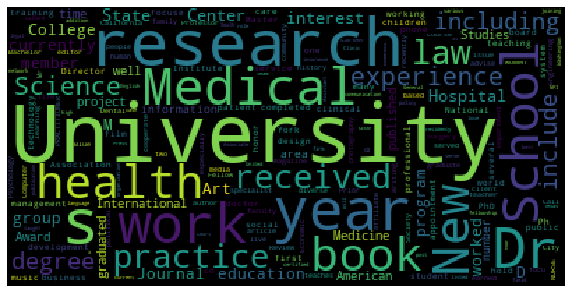

In [21]:
plt.figure(figsize=(10,10))
plt.imshow(wordcloud_word,cmap=plt.cm.Paired)
plt.axis("off")
plt.show()

In [29]:
DATA_CLEANED_PATH = DATA_PATH + '/cleaned'
ct = CleanText(stemming=True, lem=False)
ct.clean_save(train_tot, 'train_tot', "description", "description_cleaned", DATA_CLEANED_PATH)

100%|████████████████████████████████████████████████████████████████████████| 217197/217197 [02:49<00:00, 1281.44it/s]


In [30]:
train_tot_clean = pd.read_csv(os.path.join(DATA_CLEANED_PATH,'train_tot_cleaned_stem.csv'),index_col=0)

In [31]:
train_tot_clean.head(5)

,Id,description,gender,Category,Category name,description_cleaned
0,0,"She is also a Ronald D. Asmus Policy Entrepreneur Fellow with the German Marshall Fund and is a Visiting Fellow at the Centre for International Studies (CIS) at the University of Oxford. This commentary first appeared at Sada, an online journal published by the Carnegie Endowment for International Peace.",F,19,professor,ronald asmus polici entrepreneur fellow german marshal fund visit fellow centr intern studi cis univers oxford commentari first appear sada onlin journal publish carnegi endow intern peac
1,2,"Dr. Aster has held teaching and research positions at Ben Gurion University, Haifa University, Hebrew University, Bar Ilan University and the University of Pennsylvania. He has also taught Jewish studies at high schools in the United Stated and Israel.",M,19,professor,dr aster held teach research posit ben gurion univers haifa univers hebrew univers bar ilan univers univers pennsylvania taught jewish studi high school unit state israel
2,10,"An elder in the United Methodist Church, she writes and lectures widely about African-American religion and is treasurer of the Society for the Study of Black Religion. She is an expert on women in the civil rights movement, and she wrote Witnessing and Testifying: Black Women, Religion, and Civil Rights (Augsburg Fortress, 2003). Contact 404-270-5527, RRoss@spelman.edu.",F,19,professor,elder unit methodist church write lectur wide african american religion treasur societi studi black religion expert women civil right movement wrote wit testifi black women religion civil right augsburg fortress contact
3,11,"She has written numerous scholarly articles on topics concerning African-Americans and Christianity, evangelicalism, churches and politics. Contact 404-651-4842 (office), 404-651-3152 (department), polacb@panther.gsu.edu.",F,19,professor,written numer scholar articl topic concern african american christian evangel church polit contact offic depart
4,12,"He is an expert on black Pentecostalism, an ordained minister in the Church of God in Christ and a member of the World Council of Churches and Pentecostals Joint Consultative Group. Contact 202-806-0753, flware@howard.edu.",M,19,professor,expert black pentecost ordain minist church god christ member world council church pentecost joint consult group contact


In [32]:
length_descriptions_clean = (train_tot_clean.description_cleaned.map(lambda train_tot_cleaned :len(train_tot_cleaned)))
print("Plus longue description :", max(length_descriptions_clean), "mots")

Plus longue description : 755 mots


In [33]:
px.box(length_descriptions_clean)

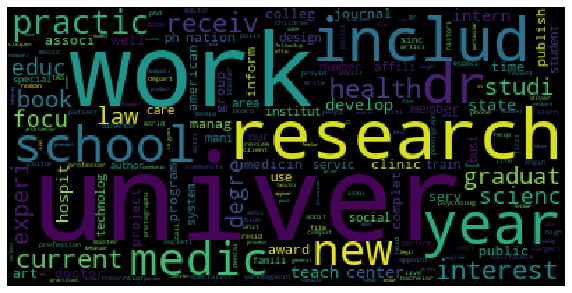

In [34]:
all_descr_clean = " ".join(train_tot_clean.description_cleaned.values)
wordcloud_word = WordCloud(background_color="black", collocations=False).generate_from_text(all_descr_clean)

plt.figure(figsize=(10,10))
plt.imshow(wordcloud_word,cmap=plt.cm.Paired)
plt.axis("off")
plt.show()

In [35]:
occurences = train_tot_clean.description_cleaned.str.split(expand=True).stack().value_counts()

In [39]:
len(occurences)

167431

In [62]:
cc

,0,1
0,112976,1
1,79880,1
2,73408,1
3,55630,1
4,52967,1
...,...,...
2007,5,4356
2008,4,6496
2009,3,11245
2010,2,26025


In [66]:
import collections
cc=pd.DataFrame(collections.Counter(occurences.values).items())
print(cc[cc[0]<=5])

      0      1
2007  5   4356
2008  4   6496
2009  3  11245
2010  2  26025
2011  1  88273


In [44]:
nb = 500
px.bar(y=occurences.head(nb).values,x=occurences.head(nb).index, labels={'x': 'Words', 'y': 'Count'})

**Comment travailler avec ce problème ?**

* Au niveau du classifieur :
    * Random Forest : class_weight = balanced
    * Boosting : scale_pos_weight = ...
    
* Au niveau du dataset : dupliquer les lignes de métiers sous représenté

In [28]:
import re
import unicodedata
import nltk
from tqdm import tqdm
import os


class CleanText:
    '''
    This class is used to clean df with text description
    '''

    def __init__(self, stemming=True, lem=False):

        english_stopwords = nltk.corpus.stopwords.words('english')
        english_stopwords.append('also')

        self.stopwords = [self.remove_accent(sw) for sw in english_stopwords]

        # Args
        self.stemming = stemming
        self.lem = lem

    @staticmethod
    def convert_text_to_lower_case(txt):
        '''
        :param txt: text (str) to put in lower case
        :return: text (str) in lower
        '''
        return txt.lower()

    @staticmethod
    def remove_accent(txt):
        '''
        :param txt: text (str) to remove accent
        :return: text (str) without accent
        '''
        return unicodedata.normalize('NFD', txt).encode('ascii', 'ignore').decode("utf-8")

    @staticmethod
    def remove_non_letters(txt):
        '''
        :param txt: text (str)
        :return: only text (str) with alphabet letters
        '''
        regex_mail = '\S+@\S+'
        regex_url = r"(?i)\b((?:https?://|www\d{0,3}[.]|[a-z0-9.\-]+[.][a-z]{2,4}/)(?:[^\s()<>]+|\(([^\s()<>]+|(\([^\s()<>]+\)))*\))+(?:\(([^\s()<>]+|(\([^\s()<>]+\)))*\)|[^\s`!()\[\]{};:'\".,<>?«»“”‘’]))"
        aux1 = re.sub(regex_url, ' ', txt)
        aux2 = re.sub(regex_mail, ' ', aux1)
        return re.sub('[^a-z_]', ' ', aux2)

    def remove_stopwords(self, txt):
        '''
        :param txt: text (str)
        :return: (list of str) without stopwords
        '''
        return [w for w in txt.split() if (w not in self.stopwords)]

    @staticmethod
    def get_stem(tokens):
        '''
        :param tokens: (list of str)
        :return: (list of str) with stemmed tokens
        '''
        stemmer = nltk.stem.SnowballStemmer('english')
        return [stemmer.stem(token) for token in tokens]

    @staticmethod
    def get_lem(tokens):
        lemmatizer = nltk.stem.WordNetLemmatizer()
        return [lemmatizer.lemmatize(token) for token in tokens]

    def apply_all_transformation(self, txt):
        '''
        apply all transformation above on a text description
        :param txt: text description (str)
        :return: (list of str) cleaned
        '''
        txt = self.convert_text_to_lower_case(txt)
        txt = self.remove_accent(txt)
        txt = self.remove_non_letters(txt)
        tokens = self.remove_stopwords(txt)
        if self.stemming:
            tokens = self.get_stem(tokens)
        if self.lem:
            tokens = self.get_lem(tokens)
        return tokens

    def clean_df_column(self, df, column_name, clean_column_name):
        '''
        clean all the text lines of the df columns and add a new columns on this df that contains the cleaned line
        :param df:
        :param column_name: column name to clean (str)
        :param clean_column_name: cleaned column name (str)
        :return: df with cleaned column
        '''
        df[clean_column_name] = [" ".join(self.apply_all_transformation(x)) for x in tqdm(df[column_name].values)]

    def get_str(self):
        str_params = '_cleaned'
        if self.stemming:
            str_params += '_stem'
        elif self.lem:
            str_params += '_lem'
        return str_params

    def clean_save(self, df, df_str, column_name, clean_column_name, DATA_CLEANED_PATH):
        self.clean_df_column(df, column_name, clean_column_name)
        df.to_csv(os.path.join(DATA_CLEANED_PATH, df_str + self.get_str() + '.csv'), index=True, encoding='utf-8')
